### Create Data Set

```s
exiftool -csv -Latitude -Longitude \
-AbsoluteAltitude -RelativeAltitude \
-GimbalRollDegree -GimbalYawDegree \
-GimbalPitchDegree -FlightRollDegree \
-FlightYawDegree -FlightPitchDegree  \
. > ../nadir_compare.csv
```

In [1]:
import os, sys
import pandas as pd
from IPython.display import Image
os.getcwd()

'/Users/axon/Engineering/NadirCompare'

In [11]:
## IMPORT DATASET
rawExifData = pd.read_csv('data/nadir_compare.csv')

## CHECK ON SOME THINGS
#rawExifData[:10]
#isinstance(rawExifData, pd.DataFrame)
#rawExifData.describe(include='all')
#rawExifData.var()

### What is Nadir?

In [9]:
rawExifData.iloc[2]

SourceFile           ./DJI_0278.JPG
Latitude                    33.8485
Longitude                  -106.874
AbsoluteAltitude                1.2
RelativeAltitude            1328.23
GimbalRollDegree                  0
GimbalYawDegree               150.2
GimbalPitchDegree             -89.9
FlightRollDegree                1.3
FlightYawDegree               168.8
FlightPitchDegree              -0.9
Name: 2, dtype: object

### Perhaps GimbalPitchDegree + FlightPitchDegree?

In [13]:
rawExifData['RelativeAltitude'].var()

0.023845383859143695

In [4]:
# CREATE NEW DF WITH 'NADIR' VALUE COLUMN
df = rawExifData
df['NadirValue'] = rawExifData['GimbalPitchDegree'] + rawExifData['FlightPitchDegree']
print(df['NadirValue'].describe())
print()
print('Variance is...')
print(df['NadirValue'].var())
print('degrees')

count    335.000000
mean     -91.218507
std        1.402911
min      -96.200000
25%      -92.050000
50%      -91.200000
75%      -90.200000
max      -82.800000
Name: NadirValue, dtype: float64

Variance is...
1.9681594423094086
degrees


### Check?
Perhaps we can check this by looking at the images with the min and max 'NadirValue'... 

SourceFile           ./DJI_0436.JPG
Latitude                    33.8485
Longitude                  -106.874
AbsoluteAltitude                1.2
RelativeAltitude            1328.23
GimbalRollDegree                  0
GimbalYawDegree                 -30
GimbalPitchDegree             -89.9
FlightRollDegree                  0
FlightYawDegree               -11.2
FlightPitchDegree              -6.3
NadirValue                    -96.2
Name: 125, dtype: object


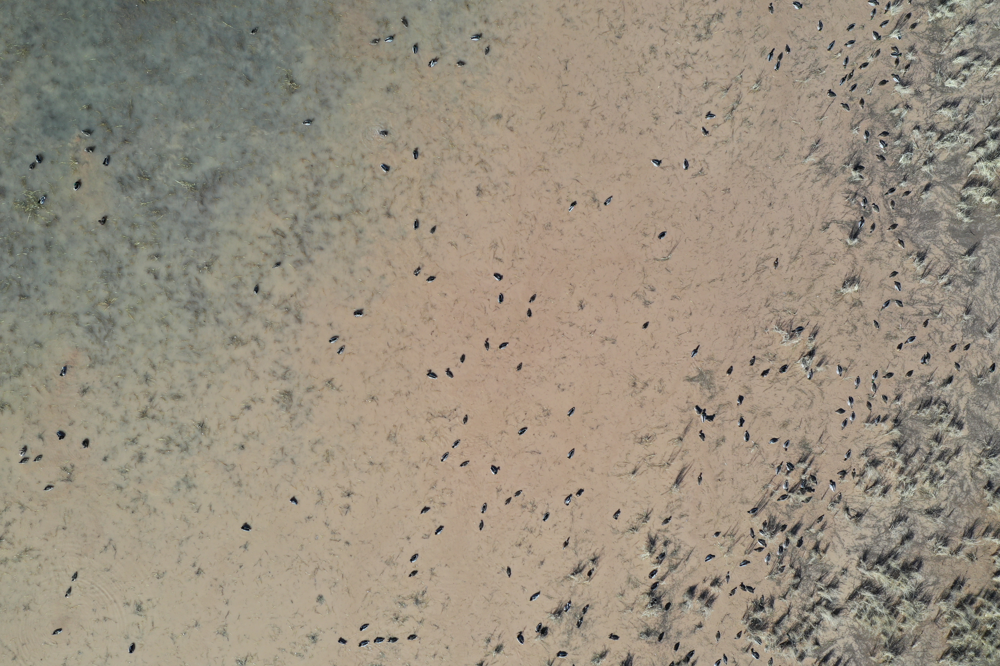

In [5]:
# Min Nadir Val
print(df.iloc[df['NadirValue'].idxmin()])
Image(filename='/Users/axon/Engineering/BDA_Nov_27_2018/BDA_12A_Flight2_30m/DJI_0436.JPG') 

SourceFile           ./DJI_0503.JPG
Latitude                    33.8477
Longitude                  -106.873
AbsoluteAltitude                1.2
RelativeAltitude            1328.23
GimbalRollDegree                  0
GimbalYawDegree                 149
GimbalPitchDegree             -89.9
FlightRollDegree              -13.5
FlightYawDegree               128.7
FlightPitchDegree               7.1
NadirValue                    -82.8
Name: 259, dtype: object


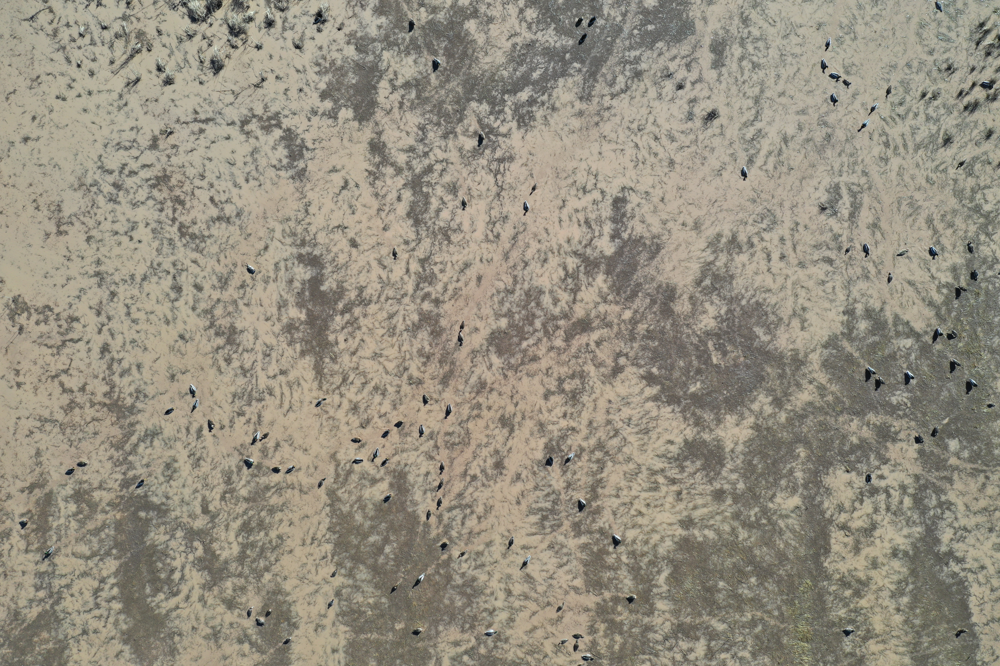

In [6]:
# Max Nadir Val
print(df.iloc[df['NadirValue'].idxmax()])
Image(filename='/Users/axon/Engineering/BDA_Nov_27_2018/BDA_12A_Flight2_30m/DJI_0503.JPG')